In [1]:
import random
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
!pip install cellpylib


  Created wheel for cellpylib: filename=cellpylib-2.2.0-py3-none-any.whl size=33853 sha256=476384f51e9aec310636b981ea7d8f6086d1affc2b8fd60af62e012ddf058f79
  Stored in directory: /Users/janilczuk/Library/Caches/pip/wheels/9f/e4/ba/f97313390461807abacc3ad22ad0ca8acda6468c8180916ac3
Successfully built cellpylib


# Zadanie 1 Deterministyczny automat komórkowy

* Dokonaj  wizualizacji  kolejnych  stanów  automatu  (wierszami)  w  postaci  obrazu binarnego.  Rozważ  rozmiar  automatu n =  100,  periodyczne  warunki  brzegowe oraz początkową gęstość miejsc aktywnych równą 0.4,0.5,0.6 (losowa inicjalizacja)

  1. gęstość 0.4




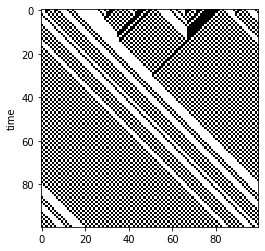

In [3]:
import cellpylib as cpl

cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.4
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

2. gęstość 0.5

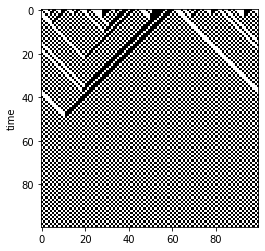

In [28]:
cellular_automaton = cpl.init_random(100)
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

3. gęstość 0.6

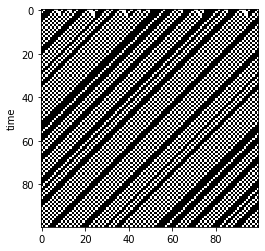

In [29]:
import cellpylib as cpl

cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.6
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

* Przedstaw ewolucję automatu dla 5 różnych losowych stanów początkowych (obraz 2D)  i  co  najmniej  100  kolejnych  kroków  czasowych.  Co  dzieje  się  z  początkowo nieuporządkowaną konfiguracją początkową? Dla jakiej gęstości początkowej miejsc aktywnych pojawia się atraktor?

1. Gęstość 0.1

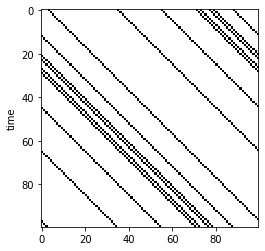

In [30]:
cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.1
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

2. Gęstość 0.3

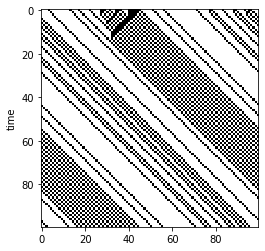

In [31]:
cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.3
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

3. Gęstość 0.5

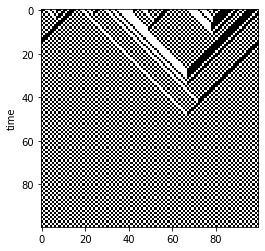

In [54]:
cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.5
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

4. Gęstość 0.7

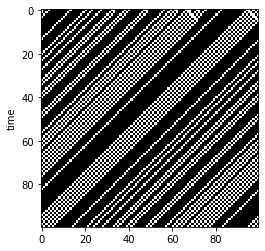

In [55]:
cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.7
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

5. Gęstość 0.9

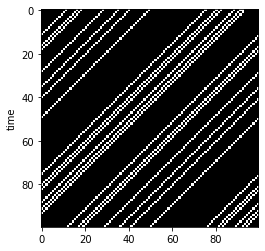

In [56]:
cellular_automaton = np.zeros((1, size), dtype=np.int8)
cellular_automaton[0, :] = np.random.rand(size) < 0.9
cellular_automaton = cpl.evolve(cellular_automaton, timesteps=100, memoize=True, 
                                apply_rule=lambda n, c, t: cpl.nks_rule(n, 184), r=1)

cpl.plot(cellular_automaton)

W przypadku reguły 184, najlepszy atraktor istnieje kiedy gęstość aktywnych stanów równa się 0.5. Z nieuporządkowanych początkowo miejsc powstaje tzw. szachownica, zawierające 2 konfiguracje
- ...01010101...
- ...10101010... 

# Zadanie 2 Probabilistyczny automat komórkowy (model ruchu ulicznego Nagela-Schreckenberga). **Implementacja własna**

* Przedstaw wizualizację działania modelu (w skali szarości, odzwierciedlającej prędkość)  dla  pierwszych  100  iteracji  przyjmując L = 100, vmax = 2  oraz p = 0.2 . Rozważ dwa losowe stany początkowe: gęstość samochodów 0.24 oraz 0.48.

1. Gęstość samochodów 0.24

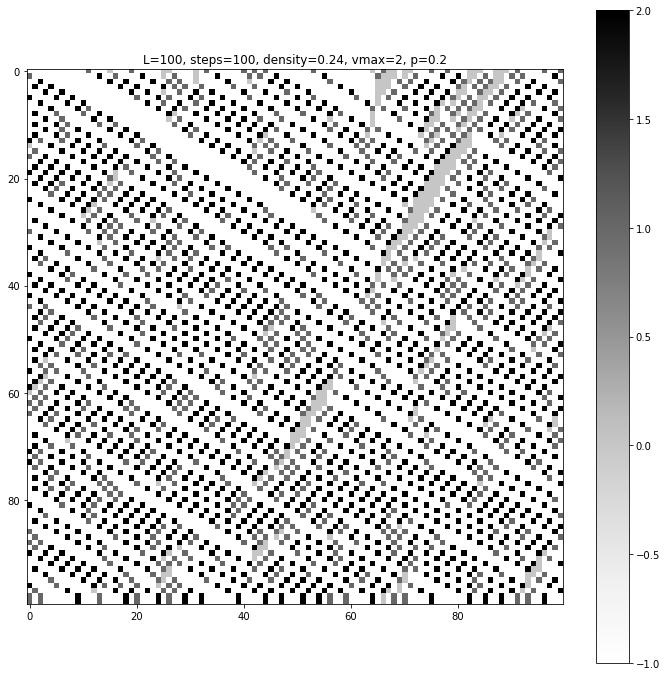

In [3]:
L = 100
steps = 100
density = 0.24
vmax = 2
p = 0.2

def step(row, new_row):
    
    for i in range(L):
        if row[i] > -1:
            vi = row[i]
            d = 1
            while row[(i + d) % L] == -1:
                d += 1
        
            vtemp = min(vi + 1, d - 1, vmax)
            if random.uniform(0, 1) < p:
                v = max(vtemp -1, 0)
            else:
                v = vtemp
            new_row[(i + v) % L] = v

    return new_row

cellular_automaton = np.ones((steps, L), dtype=np.int32)

cellular_automaton[0, :] = np.random.rand(L) > density
cellular_automaton = np.where(cellular_automaton == 1, -1, cellular_automaton)

for i in range(steps - 1):
    cellular_automaton[i, :] = step(cellular_automaton[i, :], cellular_automaton[i + 1, :])

plt.figure(figsize=(12, 12))
plt.gray()
plt.imshow(cellular_automaton, cmap="Greys", interpolation="nearest", vmin = -1,vmax = vmax)
plt.title(f"L={L}, steps={steps}, density={density}, vmax={vmax}, p={p}")
plt.colorbar()
plt.show() 

2. Gęstość samochodów 0.48

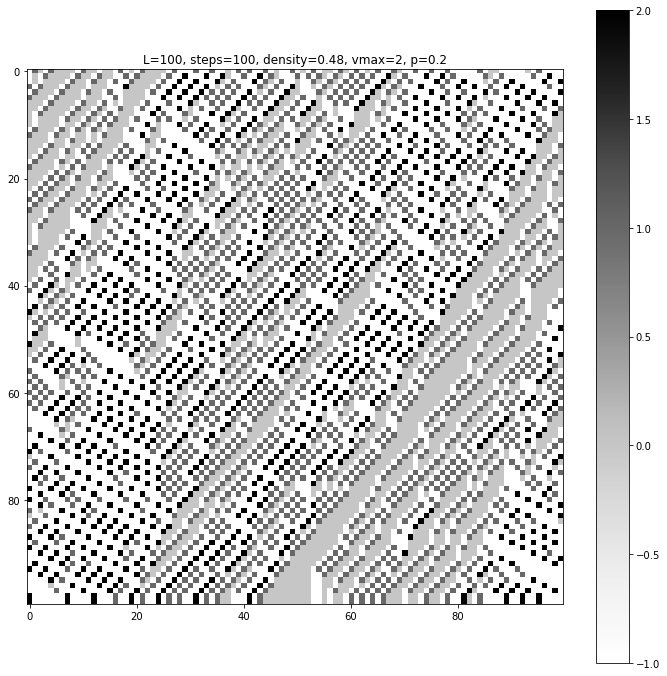

In [4]:
L = 100
steps = 100
density = 0.48
vmax = 2
p = 0.2

def step(row, new_row):
    
    for i in range(L):
        if row[i] > -1:
            vi = row[i]
            d = 1
            while row[(i + d) % L] == -1:
                d += 1
        
            vtemp = min(vi + 1, d - 1, vmax)
            if random.uniform(0, 1) < p:
                v = max(vtemp -1, 0)
            else:
                v = vtemp
            new_row[(i + v) % L] = v

    return new_row

cellular_automaton = np.ones((steps, L), dtype=np.int32)

cellular_automaton[0, :] = np.random.rand(L) > density
cellular_automaton = np.where(cellular_automaton == 1, -1, cellular_automaton)

for i in range(steps - 1):
    cellular_automaton[i, :] = step(cellular_automaton[i, :], cellular_automaton[i + 1, :])

plt.figure(figsize=(12, 12))
plt.gray()
plt.imshow(cellular_automaton, cmap="Greys", interpolation="nearest", vmin = -1,vmax = vmax)
plt.title(f"L={L}, steps={steps}, density={density}, vmax={vmax}, p={p}")
plt.colorbar()
plt.show() 

* ∗Stwórz 5 animowanych GIFów przedstawiających różne sytuacje drogowe dla różnych gęstości początkowych samochodów: pokaż fale start-stop, korki, ruch laminarny

In [5]:
!mkdir plots
!mkdir gifs

In [6]:
import imageio
import os

L = 100
steps = 100
density = 0.24
vmax = 2
p = 0.2

def step(row, new_row):
    
    for i in range(L):
        if row[i] > -1:
            vi = row[i]
            d = 1
            while row[(i + d) % L] == -1:
                d += 1
        
            vtemp = min(vi + 1, d - 1, vmax)
            if random.uniform(0, 1) < p:
                v = max(vtemp -1, 0)
            else:
                v = vtemp
            new_row[(i + v) % L] = v

    return new_row

cellular_automaton = np.ones((steps, L), dtype=np.int32)

cellular_automaton[0, :] = np.random.rand(L) > density
cellular_automaton = np.where(cellular_automaton == 1, -1, cellular_automaton)

for i in range(steps - 1):
    cellular_automaton[i, :] = step(cellular_automaton[i, :], cellular_automaton[i + 1, :])
 

filenames=[]
for i in range(cellular_automaton.shape[0]):
    plt.figure(figsize=(12, 12))
    plt.gray()
    plt.imshow(cellular_automaton[[i], :], cmap="Greys", interpolation="nearest", vmin = -1,vmax = vmax)
    plt.title(f"L={L}, steps={steps}, density={density}, vmax={vmax}, p={p}")
    plt.colorbar()
    filename = f"plots/{i}.png"
    filenames.append(filename)
    plt.savefig(filename)
    plt.close()

with imageio.get_writer(f"gifs/nn{density}.gif", mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    for filename in set(filenames):
        os.remove(filename)

1. Gęstość 0.1

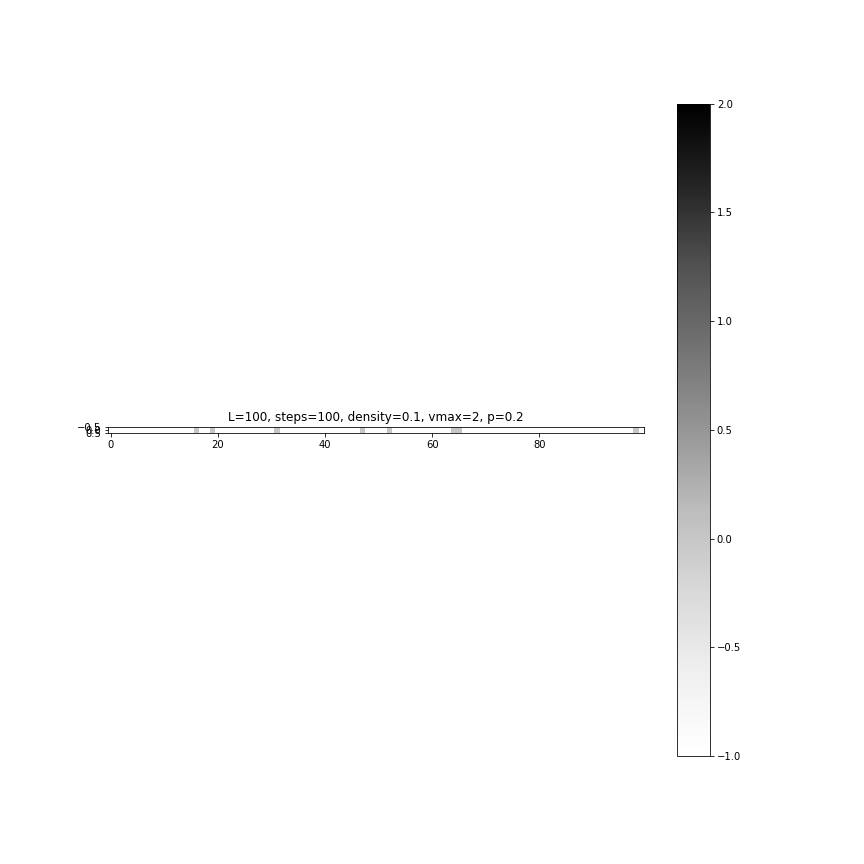

Widzimy ruch laminarny przy gęstości równej 0.1

2. Gęstość 0.24
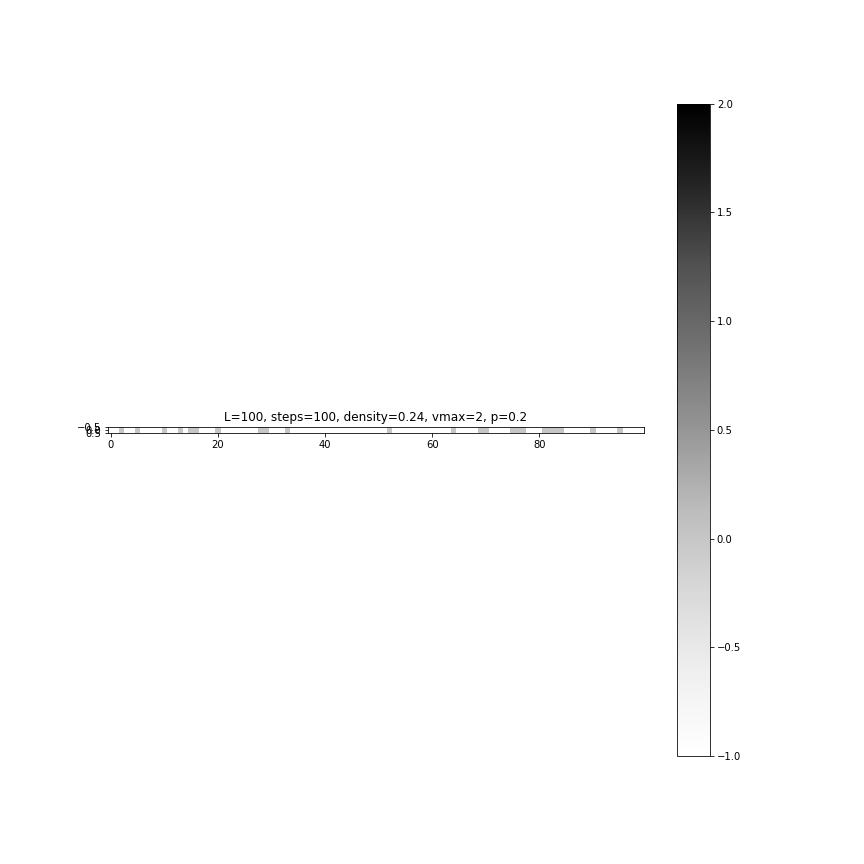
Widzimy ruch laminarny przy gęstości równej 0.24

3. Gęstość 0.48
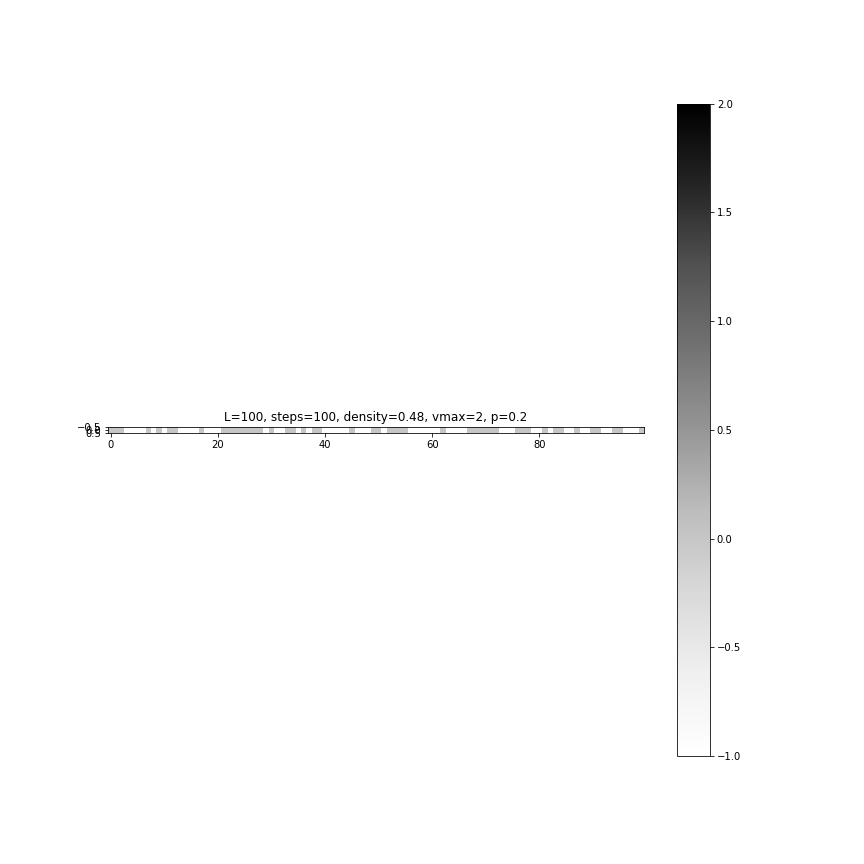
Widzimy fale start-stop przy gęstości równej 0.48

4. Gęstość 0.7
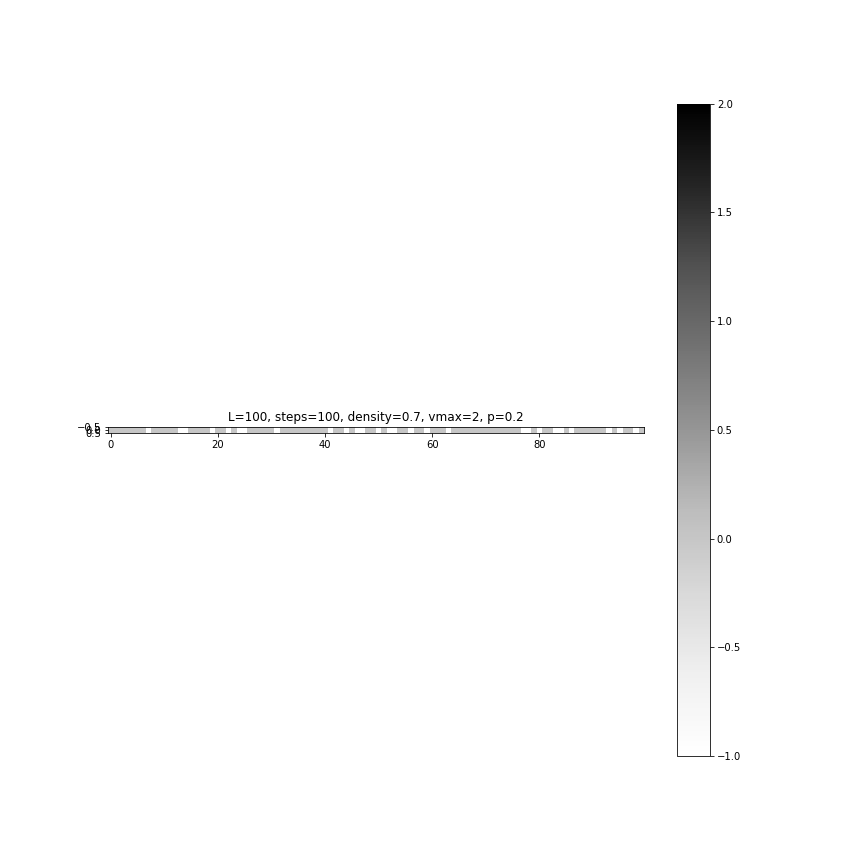
Widzimy fale start-stop przypominającego już powoli korek przy gęstości równej 0.7

5. Gęstość 0.9
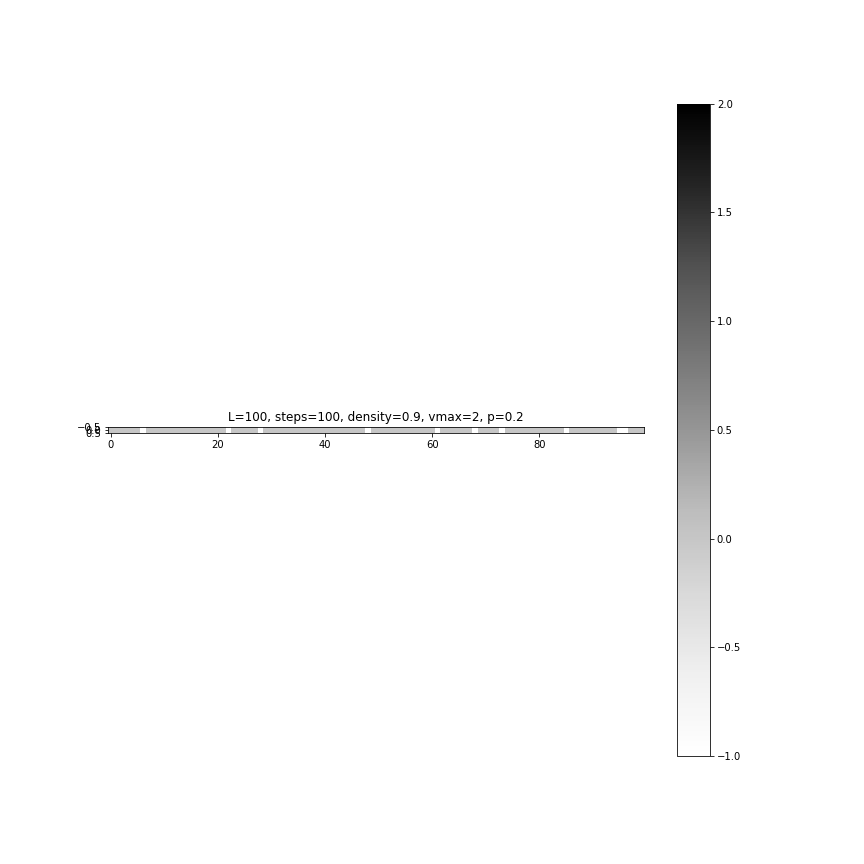
Widzimy korek przy gęstości równej 0.9